In [1]:
import pandas as pd
from sklearn.cluster import OPTICS, cluster_optics_dbscan
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import numpy as np



In [2]:
from sklearn.model_selection import train_test_split, cross_val_score 

from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.metrics import roc_curve, auc, roc_auc_score

In [3]:
df = pd.read_csv("/Users/matteoppa/Desktop/fma_metadata/df_to_work1.csv")

In [4]:
column2drop= ["season=autumn", "season=spring", "season=summer", "season=winter", "weekend", "Unnamed: 0"]

In [5]:
df.drop(column2drop, inplace=True, axis=1)

In [6]:
class_name = 'liked'

In [7]:
df

,comments_3,favorites_1,favorites_2,listens_1,tracks,type,bit_rate,duration,genre_top,number,year,liked
0,0.0,0.016129,0.001037,0.003397,0.018377,0,0.714286,0.017439,5,0.027451,0.915966,0
1,0.0,0.048387,0.007261,0.005651,0.012251,2,0.571430,0.011662,13,0.027451,0.899160,1
2,0.0,0.016129,0.001037,0.001249,0.016845,0,0.428573,0.007575,5,0.031373,0.941176,0
3,0.0,0.016129,0.001037,0.000295,0.021440,0,0.714286,0.017602,5,0.023529,0.915966,1
4,0.0,0.032258,0.025934,0.002689,0.033691,0,0.428573,0.007302,5,0.039216,0.915966,0
...,...,...,...,...,...,...,...,...,...,...,...,...
79125,0.0,0.129032,0.814315,0.108406,0.055130,0,0.714286,0.010027,5,0.000000,0.932773,1
79126,0.0,0.016129,0.017635,0.006112,0.093415,0,0.714286,0.019019,5,0.215686,0.949580,0
79127,0.0,0.016129,0.002075,0.000223,0.070444,0,0.571430,0.003270,5,0.050980,0.915966,0
79128,0.0,0.016129,0.006224,0.000567,0.010720,0,0.571430,0.005450,13,0.015686,0.899160,1


In [8]:
attributes = [col for col in df.columns if col != class_name]
X = df[attributes].values
y = df[class_name]

In [9]:
X.shape

(79130, 11)

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=100, stratify=y)

In [10]:
optic = OPTICS(min_samples=5, max_eps=5, metric='minkowski', p=3, cluster_method="dbscan", eps=None, algorithm='auto', n_jobs=-1)

In [11]:
optic.fit(X)

OPTICS(cluster_method='dbscan', max_eps=5, n_jobs=-1, p=3)

In [12]:
np.unique(optic.labels_, return_counts=True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
        168, 169, 170, 171, 172, 173, 174, 175, 176

In [20]:
optic1 = OPTICS(min_samples=5, max_eps=5, metric='minkowski', p=3, cluster_method="dbscan", eps=None, algorithm='auto', n_jobs=-1)

In [21]:
optic1.fit(df)

OPTICS(cluster_method='dbscan', max_eps=5, n_jobs=-1, p=3)

In [22]:
np.unique(optic1.labels_, return_counts=True)

(array([ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,
         25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,
         38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,
         51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,
         64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,
         77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,
         90,  91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102,
        103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115,
        116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128,
        129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141,
        142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154,
        155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167,
        168, 169, 170, 171, 172, 173, 174, 175, 176

In [13]:
optic.labels_[:10]

array([-1, -1,  0,  0,  0,  0,  0,  0,  0,  0])

In [42]:
i = df.columns.values.tolist().index('favorites_2')
j = df.columns.values.tolist().index('duration')

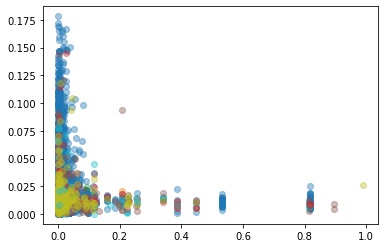

In [43]:
for cluster_id in np.unique(optic.labels_)[:20]:
    indexes = np.where(optic.labels_==cluster_id)
    plt.scatter(X[indexes,i], X[indexes,j], alpha=0.4)

In [17]:
from sklearn.metrics import silhouette_samples, silhouette_score

In [66]:
silhouette_avg = silhouette_score(X, optic.labels_)
print("The average silhouette_score is :", silhouette_avg)

The average silhouette_score is : -0.23386125460223542


# DBSCAN

In [10]:
from sklearn.cluster import DBSCAN
from sklearn.

In [11]:
dbscan = DBSCAN(eps=0.05, min_samples=8)

In [12]:
dbscan.fit(X)

DBSCAN(eps=0.05, min_samples=8)

In [13]:
i = df.columns.values.tolist().index('favorites_2')
j = df.columns.values.tolist().index('duration')

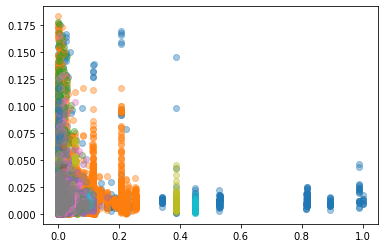

In [15]:
for cluster_id in np.unique(dbscan.labels_)[:20]:
    indexes = np.where(dbscan.labels_==cluster_id)
    plt.scatter(X[indexes,i], X[indexes,j], alpha=0.4)

In [18]:
silhouette_avg = silhouette_score(X, dbscan.labels_)
print("The average silhouette_score is :", silhouette_avg)

The average silhouette_score is : -0.11153731939308673


# X Means

In [1]:
from pyclustering.cluster import cluster_visualizer
from pyclustering.cluster.xmeans import xmeans
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from pyclustering.utils import read_sample
from pyclustering.samples.definitions import SIMPLE_SAMPLES

In [11]:
from pyclustering.cluster import cluster_visualizer_multidim

In [14]:
from pyclustering.cluster import xmeans

In [35]:
xm = xmeans.xmeans(X, kmax=50)
xm.process()

In [36]:
clusters = xm.get_clusters()
centers = xm.get_centers()

In [33]:
i = df.columns.values.tolist().index('favorites_2')
j = df.columns.values.tolist().index('duration')

In [18]:
from pyclustering.cluster.silhouette import silhouette

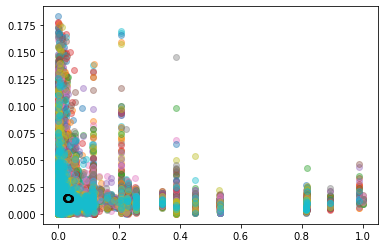

In [37]:
for indexes in clusters:
    plt.scatter(X[indexes,i], X[indexes,j], alpha=0.4)
for c in centers:
    plt.scatter(c[i], c[j], edgecolors='k')

In [21]:
# Calculate Silhouette score
score = silhouette(X, clusters).process().get_score()
np.average(score)

0.6880854707508384